# This notebook is for BCGL's *Beyond Words* tests. 
Benjamin Charles Germain Lee
(bcgl@cs.washington.edu)

Utilizing Detectron2, it finetunes a pre-trained image recognition model to put bounding boxes on Photographs, Comics/Cartoons, and Maps in historical newspaper images, while ignoring advertisements.  


This notebook is based on the following notebooks:

- https://colab.research.google.com/drive/16jcaJoc6bCFAQ96jDe2HwtXj7BMD_-m5
- https://www.dlology.com/blog/how-to-train-detectron2-with-custom-coco-datasets/


First, we mount give the notebook permissions to read from Google Drive (where the training/validation/test examples are stored):

In [1]:
from google.colab import drive
drive.mount('/gdrive/')
!ls /gdrive

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /gdrive/
'My Drive'  'Shared drives'


This code sets the base path within the notebook and does an "ls" to make sure it's in the right directory (*note:  if you are trying to get this notebook to work, I recommend creating a directory alled "beyond_words" within "colab_files" and storing ("images" and "trainval.json" there*).  

In [2]:
import os

BASE_PATH = '/gdrive/My Drive/colab_files/beyond_words/'
os.chdir(BASE_PATH)
!ls

ChronAm		     images  test_80_percent.json      trainval.json
evaluation_examples  old     trainval_80_percent.json


This cell takes care of some of the dependencies needed for Detectron2:

In [3]:
# install dependencies
!pip install -U torch torchvision cython
!pip install -U 'git+https://github.com/facebookresearch/fvcore.git' 'git+https://github.com/cocodataset/cocoapi.git#subdirectory=PythonAPI'
import torch, torchvision
torch.__version__

Requirement already up-to-date: torch in /usr/local/lib/python3.6/dist-packages (1.3.1)
Requirement already up-to-date: torchvision in /usr/local/lib/python3.6/dist-packages (0.4.2)
Requirement already up-to-date: cython in /usr/local/lib/python3.6/dist-packages (0.29.14)
  Cloning https://github.com/facebookresearch/fvcore.git to /tmp/pip-req-build-hzuzlkru
  Running command git clone -q https://github.com/facebookresearch/fvcore.git /tmp/pip-req-build-hzuzlkru
  Cloning https://github.com/cocodataset/cocoapi.git to /tmp/pip-req-build-n3tcz9jp
  Running command git clone -q https://github.com/cocodataset/cocoapi.git /tmp/pip-req-build-n3tcz9jp
     |████████████████████████████████| 266kB 6.9MB/s 
  Created wheel for fvcore: filename=fvcore-0.1-cp36-none-any.whl size=50315 sha256=de47757a6af22f885aa8a3bdc867bdd3de26b47bc37ef2cb1cecc468d4eaf79d
  Stored in directory: /tmp/pip-ephem-wheel-cache-bbzh2zpg/wheels/48/53/79/3c6485543a4455a0006f5db590ab9957622b6227011941de06
  Created wheel f

'1.3.1'

This handles the installation of Detectron2:

In [1]:
!git clone https://github.com/facebookresearch/detectron2 detectron2_repo
!pip install -e detectron2_repo

Cloning into 'detectron2_repo'...
remote: Enumerating objects: 1610, done.
remote: Total 1610 (delta 0), reused 0 (delta 0), pack-reused 1610
Receiving objects: 100% (1610/1610), 1.67 MiB | 28.43 MiB/s, done.
Resolving deltas: 100% (994/994), done.
Obtaining file:///content/detectron2_repo
  Found existing installation: detectron2 0.1
    Can't uninstall 'detectron2'. No files were found to uninstall.
  Running setup.py develop for detectron2


This cell imports a bunch of the libraries needed and constructs a COCO instance using the "trainval.json" and "test.json"; essentially, this enables the model to handle the data loading using the COCO framework (this is why the data is structured in the COCO format):

In [2]:
# You may need to restart your runtime prior to this, to let your installation take effect
# Some basic setup
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import cv2
import random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer

## 
from detectron2.data.datasets import register_coco_instances
from detectron2.data import DatasetCatalog, MetadataCatalog

import os
BASE_PATH = '/gdrive/My Drive/colab_files/beyond_words/'

!pwd
!ls -l
os.chdir(BASE_PATH)

register_coco_instances("beyond_words_train_val", {}, "trainval_80_percent.json", "images")
register_coco_instances("beyond_words_test", {}, "test_80_percent.json", "images")
register_coco_instances("beyond_words_combined", {}, "trainval.json", "images")


!pwd

/content
total 8
drwxr-xr-x 15 root root 4096 Dec  3 18:13 detectron2_repo
drwxr-xr-x  1 root root 4096 Nov 21 16:30 sample_data
/gdrive/My Drive/colab_files/beyond_words


This cell visualizes some examples from the training set (code for visualizing the images are from here: https://medium.com/@chengweizhang2012/how-to-train-detectron2-with-custom-coco-datasets-4d5170c9f389)

/gdrive/My Drive/colab_files/beyond_words
total 3492
drwx------  2 root root    4096 Nov 27 01:36 ChronAm
drwx------ 15 root root    4096 Dec  3 18:10 detectron2_repo
drwx------  2 root root    4096 Nov 22 06:13 evaluation_examples
drwx------  2 root root    4096 Dec  2 16:04 images
drwx------  2 root root    4096 Dec  1 22:32 old
-rw-------  1 root root  345355 Dec  2 16:40 test_80_percent.json
-rw-------  1 root root 1431622 Dec  2 16:04 trainval_80_percent.json
-rw-------  1 root root 1776706 Dec  2 16:04 trainval.json
WARNING [12/03 18:24:48 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[12/03 18:24:48 d2.data.datasets.coco]: Loaded 2748 images in COCO format from trainval_80_percent.json
[{'file_name': 'images/1.jpg', 'height': 1330, 'width': 912, 'image_id': 1, 'annotations': [{'iscrowd': 0, 'bbox': [612, 92, 271, 338], 'category_id': 0, 'bbox_mode': <BoxMode.XYWH_ABS: 1>}]}, {'file_name': 'images/2.jpg', 'height

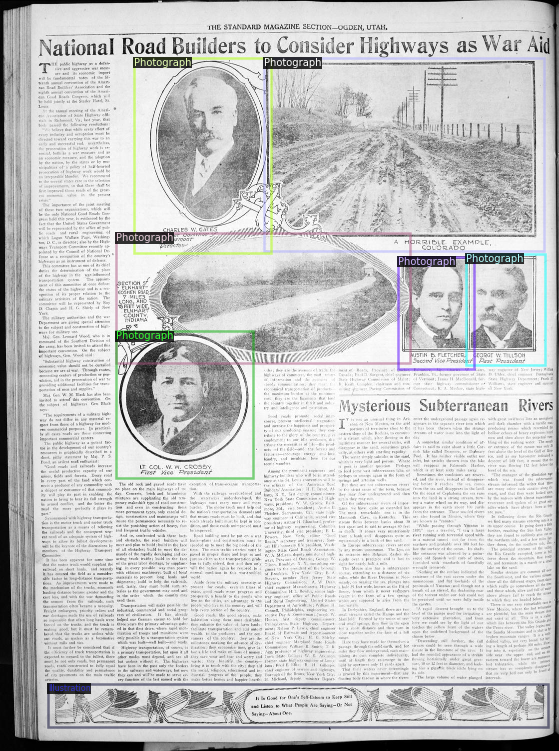

images/1723.jpg
/gdrive/My Drive/colab_files/beyond_words


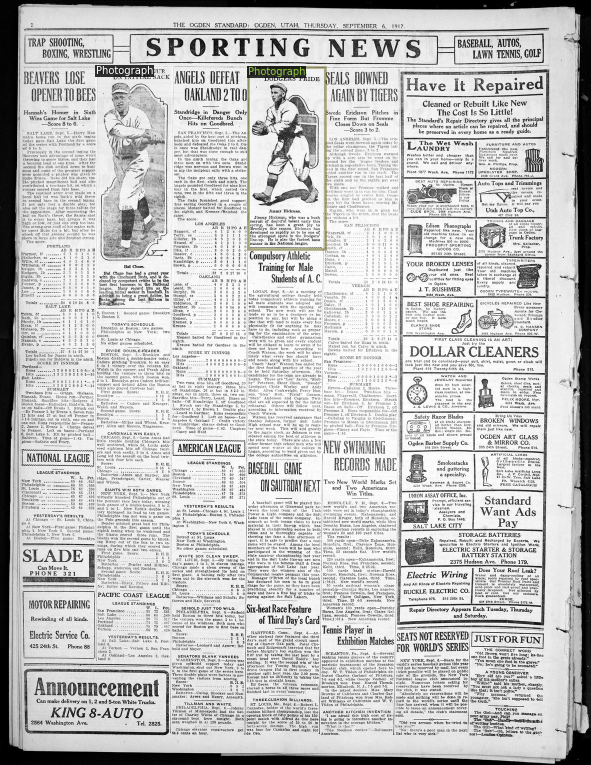

images/166.jpg
/gdrive/My Drive/colab_files/beyond_words


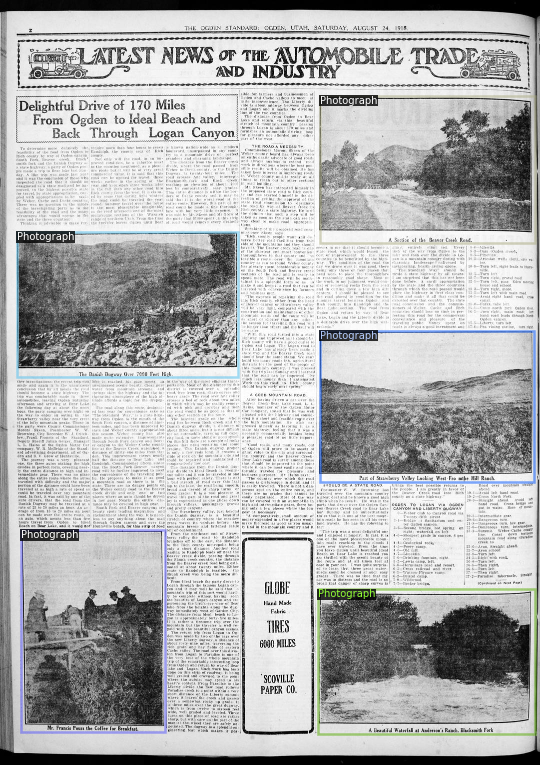

images/1061.jpg
/gdrive/My Drive/colab_files/beyond_words


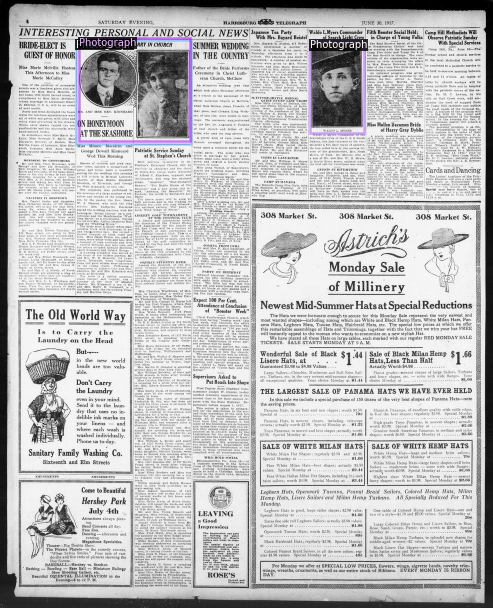

images/2095.jpg
/gdrive/My Drive/colab_files/beyond_words


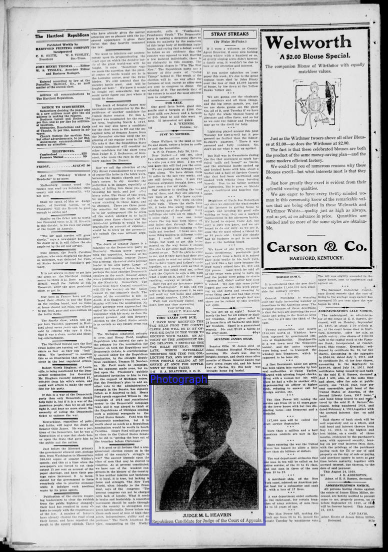

In [3]:
import random
from detectron2.utils.visualizer import Visualizer
from detectron2.data import DatasetCatalog, MetadataCatalog

# sets random seed for reproducibility
random.seed(0)

!pwd 
!ls -l

dataset_dicts = DatasetCatalog.get("beyond_words_train_val")
my_metadata = MetadataCatalog.get("beyond_words_train_val")

print(dataset_dicts)

for d in random.sample(dataset_dicts, 5):
    print(d["file_name"])
    !pwd
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=my_metadata, scale=0.5)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])

# WE COMPARE FASTER-RCNN IMPLEMENTATIONS THAT ONLY RELY ON BOUNDING BOXES
 - Can pick here: https://github.com/facebookresearch/detectron2/blob/master/MODEL_ZOO.md#coco-person-keypoint-detection-baselines-with-keypoint-r-cnn


*Note*: currently, Detectron2 only supports a couple of different data augmentation techniques (ResizeShortestEdge and RandomFlip); see https://github.com/facebookresearch/Detectron/blob/master/detectron/datasets/roidb.py#L76 for more details.


First, we start with Faster_rcnn_R_50_FPN_3x and evaluate mean average precision on the held-out data (80%-20% split for train and test):


In [4]:
from detectron2.engine import DefaultTrainer
from detectron2.config import get_cfg
from detectron2.evaluation import COCOEvaluator


cfg = get_cfg()
# loads in correct pre-trained model parameters
cfg.merge_from_file("./detectron2_repo/configs/COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml")
# loads pre-trained model weights (from Model Zoo)
cfg.MODEL.WEIGHTS = "detectron2://COCO-Detection/faster_rcnn_R_50_FPN_3x/137849458/model_final_280758.pkl"
# loads in training/val/test data using the registered COCO instance
cfg.DATASETS.TRAIN = ("beyond_words_train_val",)
cfg.DATASETS.TEST = ("beyond_words_test",)
# sets number of object classes (5:  "Illustration/Photograph", "Photograph", "Comics/Cartoon", "Editorial Cartoon", "Map")
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 5

# some hyperparameters
cfg.SOLVER.BASE_LR = 0.00025
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 64
cfg.SOLVER.MAX_ITER = 1000
cfg.DATALOADER.NUM_WORKERS = 2
cfg.SOLVER.IMS_PER_BATCH = 2

# makes output directory for weights, etc.
os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)

# trains 
trainer = DefaultTrainer(cfg) 
trainer.resume_or_load(resume=False)
trainer.train()

# tests
# note:  this command is quite tricky to get right (took 2 hours)
trainer.test(trainer.cfg, trainer.model, COCOEvaluator("beyond_words_test", trainer.cfg, False, trainer.cfg.OUTPUT_DIR))

for i in range(0, 30):

  # trains again
  cfg.SOLVER.MAX_ITER = 1000*(i+1)
  trainer = DefaultTrainer(cfg) 
  trainer.resume_or_load(resume=True)
  trainer.train()

  # tests again
  trainer.test(trainer.cfg, trainer.model, COCOEvaluator("beyond_words_test", trainer.cfg, False, trainer.cfg.OUTPUT_DIR))



WARNING [12/03 18:26:30 d2.config.compat]: Config './detectron2_repo/configs/COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml' has no VERSION. Assuming it to be compatible with latest v2.
[12/03 18:26:36 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv

model_final_280758.pkl: 167MB [00:03, 44.7MB/s]                           
'roi_heads.box_predictor.cls_score.weight' has shape (81, 1024) in the checkpoint but (6, 1024) in the model! Skipped.
'roi_heads.box_predictor.cls_score.bias' has shape (81,) in the checkpoint but (6,) in the model! Skipped.
'roi_heads.box_predictor.bbox_pred.weight' has shape (320, 1024) in the checkpoint but (20, 1024) in the model! Skipped.
'roi_heads.box_predictor.bbox_pred.bias' has shape (320,) in the checkpoint but (20,) in the model! Skipped.


[12/03 18:26:42 d2.engine.train_loop]: Starting training from iteration 0
[12/03 18:26:50 d2.utils.events]: eta: 0:04:51  iter: 19  total_loss: 2.391  loss_cls: 1.635  loss_box_reg: 0.653  loss_rpn_cls: 0.032  loss_rpn_loc: 0.015  time: 0.3944  data_time: 0.1525  lr: 0.000005  max_mem: 2414M
[12/03 18:26:59 d2.utils.events]: eta: 0:05:23  iter: 39  total_loss: 2.201  loss_cls: 1.544  loss_box_reg: 0.599  loss_rpn_cls: 0.035  loss_rpn_loc: 0.016  time: 0.4122  data_time: 0.2338  lr: 0.000010  max_mem: 2414M
[12/03 18:27:08 d2.utils.events]: eta: 0:05:39  iter: 59  total_loss: 1.957  loss_cls: 1.348  loss_box_reg: 0.548  loss_rpn_cls: 0.036  loss_rpn_loc: 0.009  time: 0.4344  data_time: 0.2894  lr: 0.000015  max_mem: 2522M
[12/03 18:27:17 d2.utils.events]: eta: 0:05:32  iter: 79  total_loss: 1.794  loss_cls: 1.125  loss_box_reg: 0.546  loss_rpn_cls: 0.033  loss_rpn_loc: 0.012  time: 0.4341  data_time: 0.2130  lr: 0.000020  max_mem: 2522M
[12/03 18:27:25 d2.utils.events]: eta: 0:05:21  it

This cell then displays TensorBoard, which shows a series of plots for tracking training: 

In [0]:
%load_ext tensorboard
%tensorboard --logdir output

This cell performs predictions on the test examples:

In [0]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5   # set the testing threshold for this model
cfg.DATASETS.TEST = ("beyond_words_test", )
predictor = DefaultPredictor(cfg)

This cell saves some sample predictions to "evaluation_examples/":

In [0]:
from detectron2.utils.visualizer import ColorMode

ct = 0

for d in random.sample(DatasetCatalog.get("beyond_words_test"), 50):    
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)
    v = Visualizer(im[:, :, ::-1],
                   metadata=my_metadata, 
                   scale=0.8    )
    v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    # cv2_imshow(v.get_image()[:, :, ::-1])
    cv2.imwrite(BASE_PATH + "evaluation_examples/" + str(ct) + ".jpg", v.get_image()[:, :, ::-1])

    ct+=1

WARNING [12/03 00:39:02 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[12/03 00:39:02 d2.data.datasets.coco]: Loaded 688 images in COCO format from test_80_percent.json


This cell shows some sample predictions in the notebook itself (for a quick coherence check):

WARNING [12/03 00:39:47 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[12/03 00:39:47 d2.data.datasets.coco]: Loaded 688 images in COCO format from test_80_percent.json


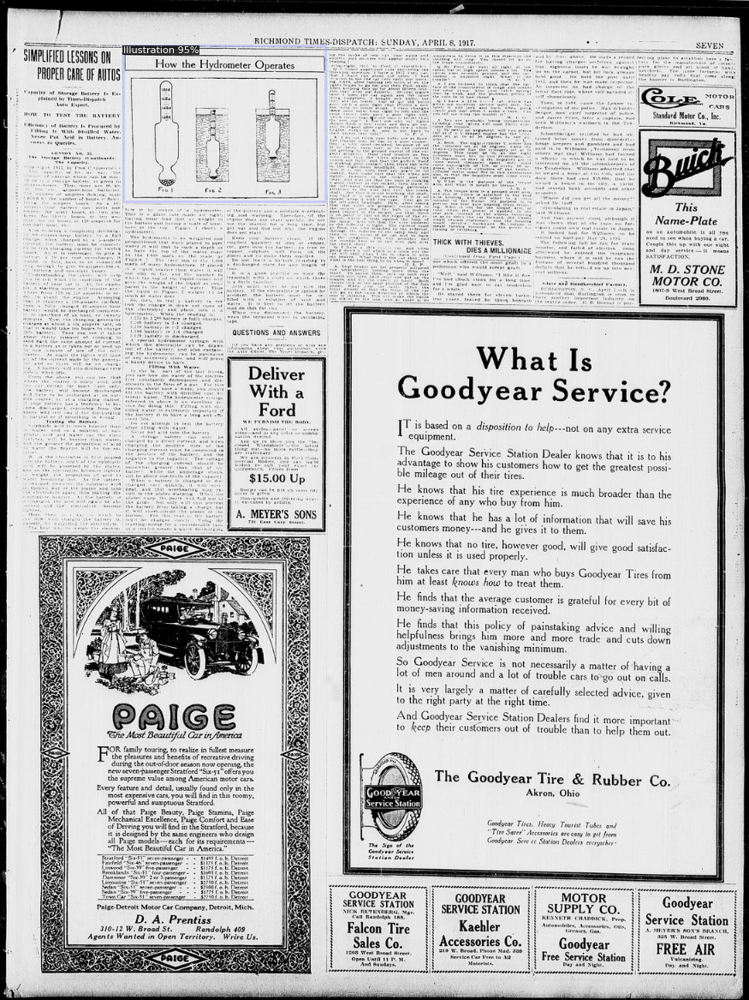

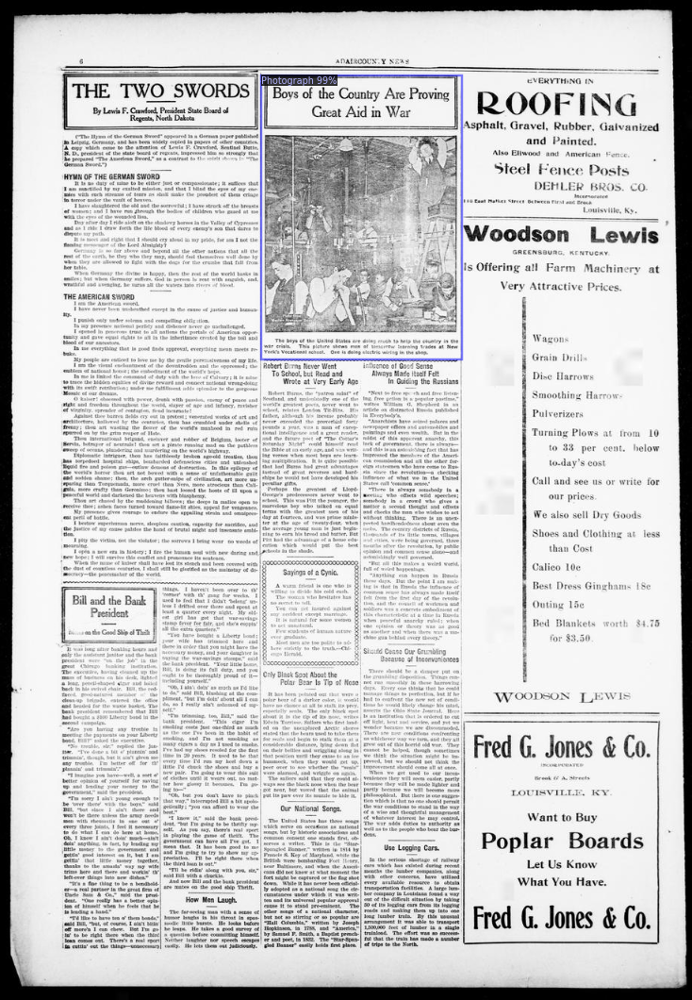

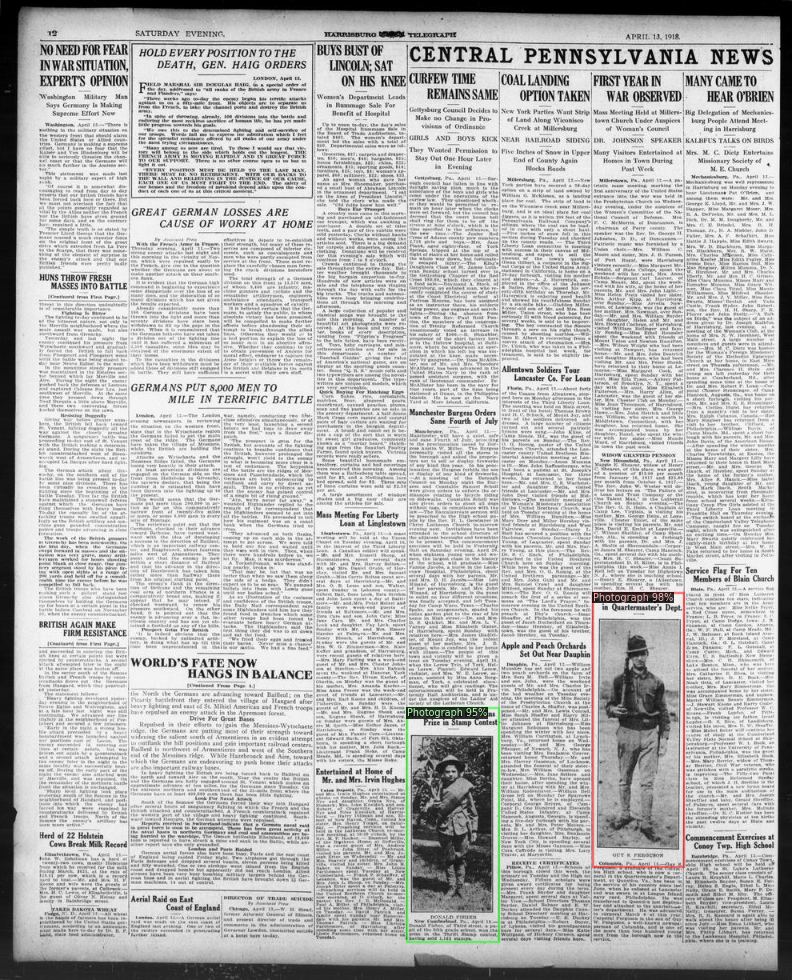

In [0]:
from detectron2.utils.visualizer import ColorMode

for d in random.sample(DatasetCatalog.get("beyond_words_test"), 3):    
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)
    v = Visualizer(im[:, :, ::-1],
                   metadata=my_metadata, 
                   scale=0.8    )
    v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(v.get_image()[:, :, ::-1])

This cell evaluates the predictions on some sample ChronAm pages that I've stored in the subdirectory "/ChronAm/*.jpg".  In particular, it predicts on all of the images and saves the prediction data as JSONs in "ChronAm/predictions/"; it also displays some predictions in the notebook for a quick coherence check.

For a description of Detectron2 instances, see here (they're confusing):  https://detectron2.readthedocs.io/modules/structures.html#detectron2.structures.Instances

Done: 10
Done: 20
Done: 30
Done: 40
Done: 50
Done: 60
Done: 70
Done: 80
Done: 90
Done: 100
Done: 110
Done: 120
Done: 130
Done: 140
Done: 150
Done: 160
Done: 170
Done: 180
Done: 190
Done: 200
Done: 210
Done: 220
Done: 230
Done: 240
Done: 250
Done: 260
Done: 270
Done: 280
Done: 290
Done: 300
Done: 310
Done: 320
Done: 330
Done: 340
Done: 350
Done: 360
Done: 370
Done: 380
Done: 390
Done: 400
Done: 410
Done: 420
Done: 430
Done: 440
Done: 450


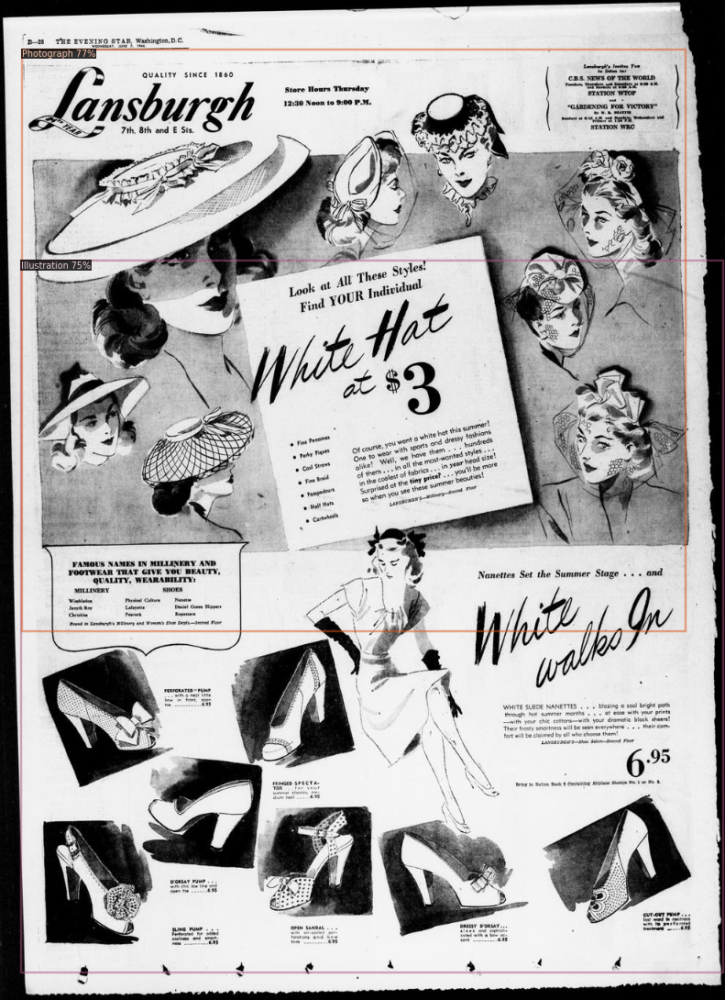

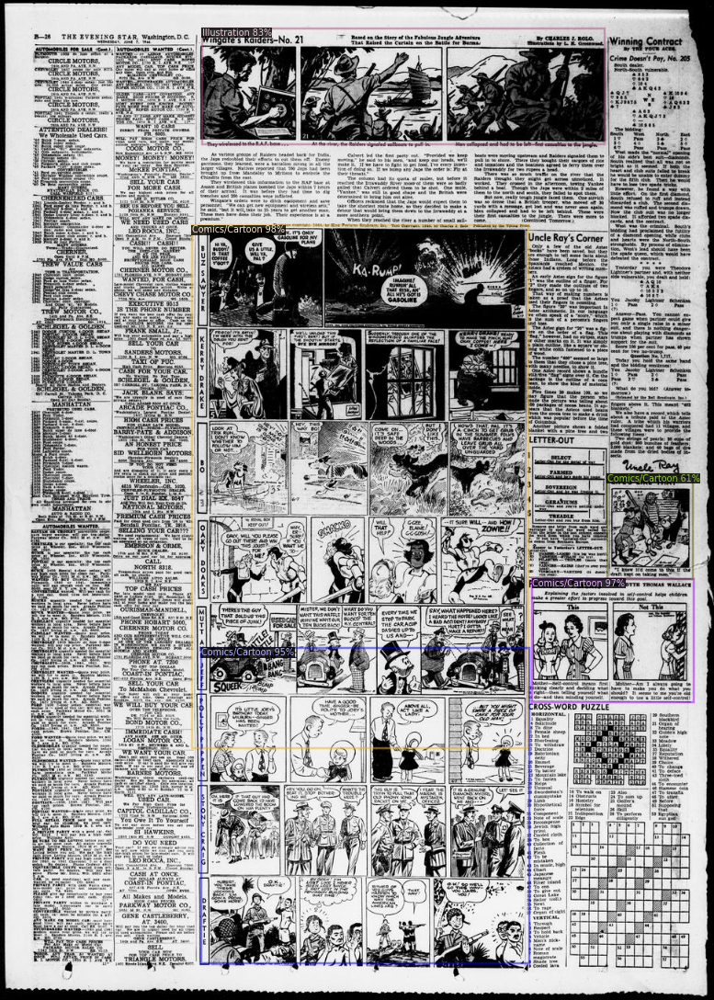

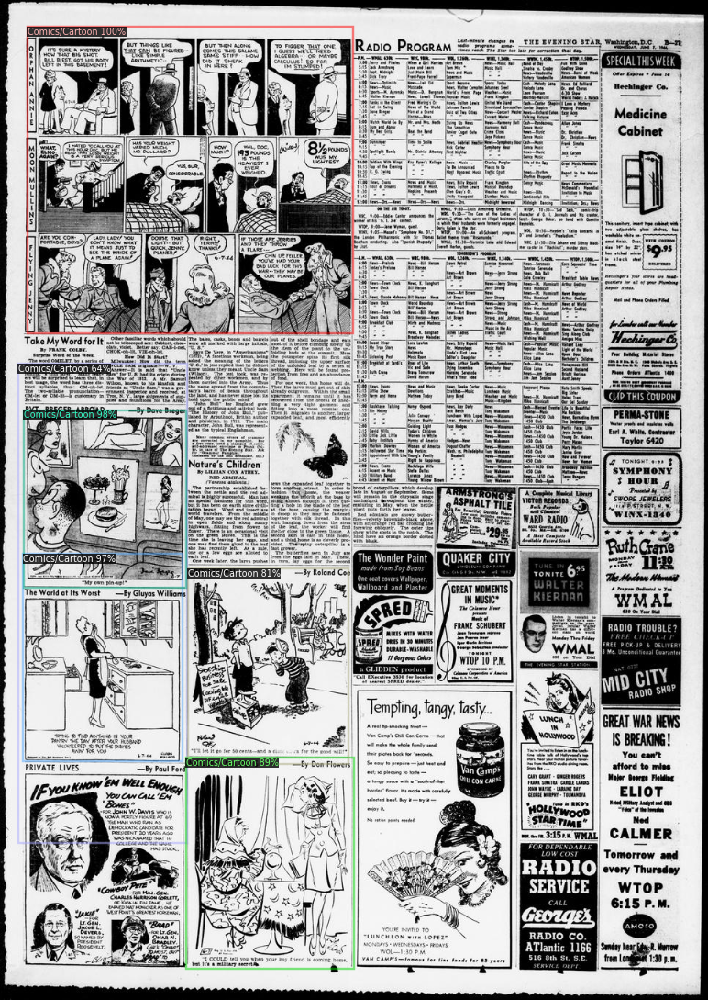

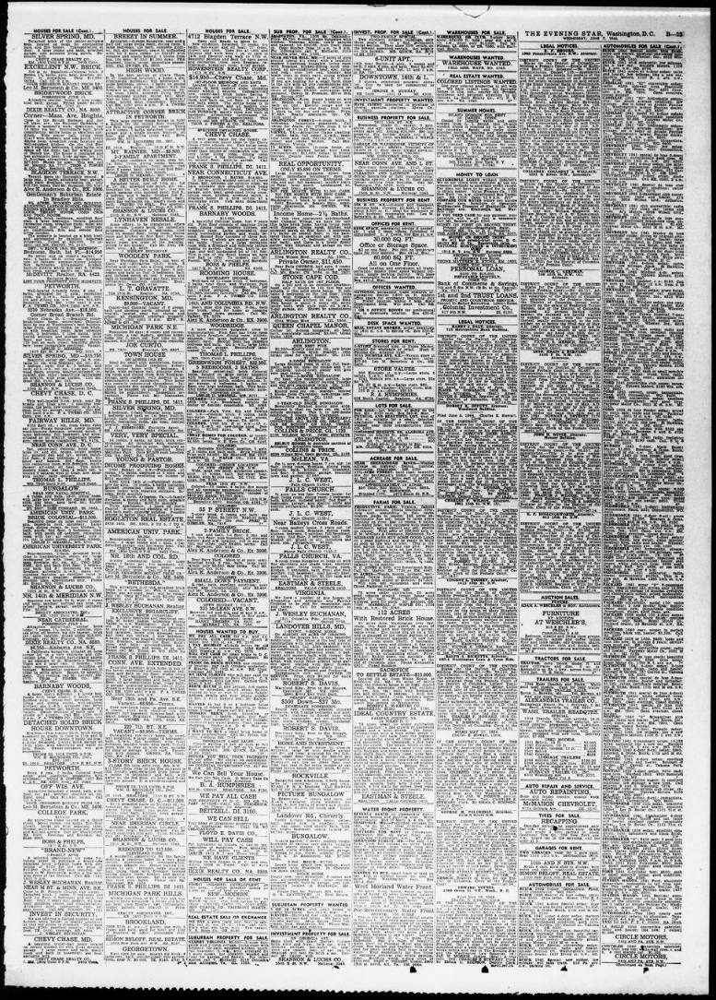

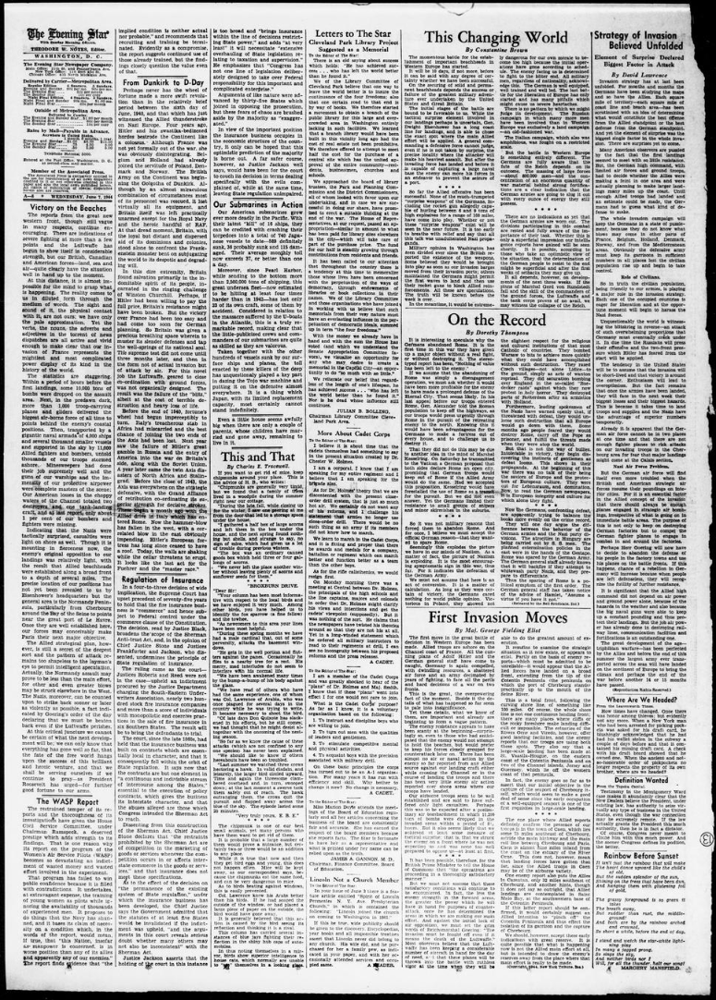

In [0]:
import glob
from detectron2.utils.visualizer import ColorMode
import json

# loads in all of the ChronAm files stored in the subdirectory
sample_chronam = glob.glob(BASE_PATH + "ChronAm/**/*.jpg", recursive=True)

ct = 0

for filename in sample_chronam:
      
    im = cv2.imread(filename)
    outputs = predictor(im)
    v = Visualizer(im[:, :, ::-1],
                   metadata=my_metadata, 
                   scale=0.8    )
    v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    # cv2_imshow(v.get_image()[:, :, ::-1])
    cv2.imwrite(BASE_PATH + "ChronAm/predictions/" + str(ct) + ".jpg", v.get_image()[:, :, ::-1])

    predictions = {}
    predictions["file_name"] = filename
    predictions["boxes"] = outputs["instances"].get_fields()["pred_boxes"].to("cpu").tensor.tolist()
    predictions["scores"] = outputs["instances"].get_fields()["scores"].to("cpu").tolist()
    predictions["pred_classes"] = outputs["instances"].get_fields()["pred_classes"].to("cpu").tolist()

    with open(BASE_PATH + "ChronAm/predictions/" + str(ct) + ".json", "w") as fp:
      json.dump(predictions, fp)

    ct+=1

    if ct % 10 == 0:
      print("Done: " + str(ct))


for filename in sample_chronam[:5]:    
    im = cv2.imread(filename)
    outputs = predictor(im)
    v = Visualizer(im[:, :, ::-1],
                   metadata=my_metadata, 
                   scale=0.8    )
    v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(v.get_image()[:, :, ::-1])


We now train on the second model "faster_rcnn_X_101_32x8d_FPN_3x":

In [0]:
from detectron2.engine import DefaultTrainer
from detectron2.config import get_cfg
from detectron2.evaluation import COCOEvaluator


cfg2 = get_cfg()
# loads in correct pre-trained model parameters
cfg2.merge_from_file("./detectron2_repo/configs/COCO-Detection/faster_rcnn_X_101_32x8d_FPN_3x.yaml")
# loads pre-trained model weights (from Model Zoo)
cfg2.MODEL.WEIGHTS = "detectron2://COCO-Detection/faster_rcnn_X_101_32x8d_FPN_3x/139173657/model_final_68b088.pkl"
# loads in training/val/test data using the registered COCO instance
cfg2.DATASETS.TRAIN = ("beyond_words_train_val",)
cfg2.DATASETS.TEST = ("beyond_words_test",)
# sets number of object classes (5:  "Illustration/Photograph", "Photograph", "Comics/Cartoon", "Editorial Cartoon", "Map")
cfg2.MODEL.ROI_HEADS.NUM_CLASSES = 5

# some hyperparameters
cfg2.SOLVER.BASE_LR = 0.00025
cfg2.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 64
cfg2.SOLVER.MAX_ITER = 1000
cfg2.DATALOADER.NUM_WORKERS = 2
cfg2.SOLVER.IMS_PER_BATCH = 2

# makes output directory for weights, etc.
os.makedirs(cfg2.OUTPUT_DIR, exist_ok=True)

# trains
trainer = DefaultTrainer(cfg2) 
trainer.resume_or_load(resume=False)
trainer.train()

# tests
# note:  this command is quite tricky to get right (took 2 hours)
trainer.test(trainer.cfg, trainer.model, COCOEvaluator("beyond_words_test", trainer.cfg, False, trainer.cfg.OUTPUT_DIR))

for i in range(0, 100):

  # trains again
  cfg2.SOLVER.MAX_ITER = 1000*(i+1)
  trainer = DefaultTrainer(cfg2) 
  trainer.resume_or_load(resume=True)
  trainer.train()

  # tests again
  trainer.test(trainer.cfg, trainer.model, COCOEvaluator("beyond_words_test", trainer.cfg, False, trainer.cfg.OUTPUT_DIR))



WARNING [12/03 01:22:52 d2.config.compat]: Config './detectron2_repo/configs/COCO-Detection/faster_rcnn_X_101_32x8d_FPN_3x.yaml' has no VERSION. Assuming it to be compatible with latest v2.
[12/03 01:22:53 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
      

'roi_heads.box_predictor.cls_score.weight' has shape (81, 1024) in the checkpoint but (6, 1024) in the model! Skipped.
'roi_heads.box_predictor.cls_score.bias' has shape (81,) in the checkpoint but (6,) in the model! Skipped.
'roi_heads.box_predictor.bbox_pred.weight' has shape (320, 1024) in the checkpoint but (20, 1024) in the model! Skipped.
'roi_heads.box_predictor.bbox_pred.bias' has shape (320,) in the checkpoint but (20,) in the model! Skipped.


[12/03 01:22:55 d2.engine.train_loop]: Starting training from iteration 0
[12/03 01:23:12 d2.utils.events]: eta: 0:14:11  iter: 19  total_loss: 2.451  loss_cls: 1.769  loss_box_reg: 0.636  loss_rpn_cls: 0.033  loss_rpn_loc: 0.016  time: 0.8858  data_time: 0.0042  lr: 0.000005  max_mem: 6009M
[12/03 01:23:30 d2.utils.events]: eta: 0:14:13  iter: 39  total_loss: 2.508  loss_cls: 1.701  loss_box_reg: 0.694  loss_rpn_cls: 0.052  loss_rpn_loc: 0.017  time: 0.8823  data_time: 0.0039  lr: 0.000010  max_mem: 6009M
[12/03 01:23:48 d2.utils.events]: eta: 0:14:08  iter: 59  total_loss: 2.306  loss_cls: 1.509  loss_box_reg: 0.777  loss_rpn_cls: 0.024  loss_rpn_loc: 0.013  time: 0.8954  data_time: 0.0039  lr: 0.000015  max_mem: 6009M
[12/03 01:24:17 d2.utils.events]: eta: 0:13:42  iter: 79  total_loss: 2.126  loss_cls: 1.288  loss_box_reg: 0.734  loss_rpn_cls: 0.035  loss_rpn_loc: 0.011  time: 1.0309  data_time: 0.5751  lr: 0.000020  max_mem: 6009M
[12/03 01:24:35 d2.utils.events]: eta: 0:13:17  it

This cell evaluates the predictions on some sample ChronAm pages that I've stored in the subdirectory "/ChronAm/*.jpg".  In particular, it predicts on all of the images and saves the prediction data as JSONs in "ChronAm/predictions/"; it also displays some predictions in the notebook for a quick coherence check. This uses the *new* model.

For a description of Detectron2 instances, see here (they're confusing):  https://detectron2.readthedocs.io/modules/structures.html#detectron2.structures.Instances

In [0]:
import glob
from detectron2.utils.visualizer import ColorMode
import json

# loads in all of the ChronAm files stored in the subdirectory
sample_chronam = glob.glob(BASE_PATH + "ChronAm/**/*.jpg", recursive=True)

ct = 0

for filename in sample_chronam:
      
    im = cv2.imread(filename)
    outputs = predictor(im)
    v = Visualizer(im[:, :, ::-1],
                   metadata=my_metadata, 
                   scale=0.8    )
    v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    # cv2_imshow(v.get_image()[:, :, ::-1])
    cv2.imwrite(BASE_PATH + "ChronAm/predictions/" + str(ct) + ".jpg", v.get_image()[:, :, ::-1])

    predictions = {}
    predictions["file_name"] = filename
    predictions["boxes"] = outputs["instances"].get_fields()["pred_boxes"].to("cpu").tensor.tolist()
    predictions["scores"] = outputs["instances"].get_fields()["scores"].to("cpu").tolist()
    predictions["pred_classes"] = outputs["instances"].get_fields()["pred_classes"].to("cpu").tolist()

    with open(BASE_PATH + "ChronAm/predictions/" + str(ct) + ".json", "w") as fp:
      json.dump(predictions, fp)

    ct+=1

    if ct % 10 == 0:
      print("Done: " + str(ct))


for filename in sample_chronam[:5]:    
    im = cv2.imread(filename)
    outputs = predictor(im)
    v = Visualizer(im[:, :, ::-1],
                   metadata=my_metadata, 
                   scale=0.8    )
    v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(v.get_image()[:, :, ::-1])
